In [49]:
%%html
<link href="https://fonts.googleapis.com/css?family=Lora:400,700|Montserrat:300" rel="stylesheet">

<link href="https://fonts.googleapis.com/css2?family=Crimson+Pro&family=Literata&display=swap" rel="stylesheet">
<style>
body {
 #font-family:  'Literata', serif;
    font-family:'Lora', san-serif;
    text-align: justify;
    font-weight: 400;
    font-size: 14pt;
}

iframe{
    width:100%;
    height:5000px;
}

h1, h2, h3, h4, h5, h6 {
# font-family: 'Montserrat', sans-serif;
 font-family:'Lora', serif;
 font-weight: 300;
 text-transform: uppercase;
 color: #EC7063 ;
}

h2 {
    color: #000080;
}

.CodeMirror pre, .CodeMirror-dialog, .CodeMirror-dialog .CodeMirror-search-field, .terminal-app .terminal {
    font-family: 'Source Code Pro Medium' , serif; 
    font-weight: 500;
    font-size: 12pt;
}


</style>

In [50]:
# Basic imports 
import numpy as np                 # gives the functions related to linear algebra
import pandas as pd                # for data processing, gives dat a frames

# Data standardizing and pre-processing import 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures  # for regresion using polynomial
from sklearn.pipeline import make_pipeline
np.random.seed(42)

# Imports for modeling and metrics

from sklearn.linear_model import LogisticRegression   # for regression analysis
from sklearn.metrics import confusion_matrix          # for confusion matrix analysis (measure of accuracy of classifiers)
from sklearn.metrics import classification_report     # for getting 'goodness of fit' report
from sklearn.metrics import roc_curve                 # to draw ROC curve (measure of accuracy of classifiers)
from sklearn.metrics import roc_auc_score             # to calculate area under ROC curve (measure of accuracy of classifiers)

# imports for linear regression
from sklearn.linear_model import LinearRegression     # for linear regression
from sklearn.metrics import mean_squared_error, r2_score


# imports for graphical 
%matplotlib inline                                    
                        # statement to show the plot by default without needing to explicitly call show()
import matplotlib.pyplot as plt  #visualisation       # for plotting
import seaborn as sns                                 # 
from matplotlib import colors                         # for color specifications
import folium

pd.set_option('plotting.backend','matplotlib')       # setting the backand for pandas to use.
plt.rcParams['figure.figsize'] = '20,10'
plt.rcParams['legend.fontsize'] = 16
plt.rcParams['axes.labelsize'] = 16
plt.style.use('ggplot')

from matplotlib import rc
rc('font', family='serif')
rc('text', usetex=False)
rc('font', size=20)

import warnings
warnings.filterwarnings('ignore')

import pandas_profiling as pdp
sns.set(style="white")
sns.set(style="whitegrid",color_codes=True)
sns.set(color_codes=True)

from sklearn.feature_selection import RFE

In [51]:
th_props = [
  ('font-size', '12pt'),
  ('text-align', 'center'),
  ('font-weight', 'bold'),
  ('color', 'cornsilk'),
  ('background-color', 'salmon')
  ]
# Set CSS properties for td elements in dataframe
td_props = [
  ('font-size', '11px'),
  #('color', 'cornsilk'),
    ('font-weight', 'normal')
  ]

# Currently, could not make this work!
first_col_props = [
    ('background-color', 'cornsilk'),
    ('color', 'black'),
    ('font-weight', 'bold'),
]

# Set table styles
styles = [
  dict(selector="th", props=th_props),
  dict(selector="td", props=td_props),
  dict(selection="tr td:first-child()", props=first_col_props)
  ]


data = pd.read_csv('data/housing.csv')
data.describe(include='all').transpose().style.set_table_styles(styles)

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
longitude,20640.000000,nan,nan,nan,-119.569704,2.003532,-124.350000,-121.800000,-118.490000,-118.010000,-114.310000
latitude,20640.000000,nan,nan,nan,35.631861,2.135952,32.540000,33.930000,34.260000,37.710000,41.950000
housing_median_age,20640.000000,nan,nan,nan,28.639486,12.585558,1.000000,18.000000,29.000000,37.000000,52.000000
total_rooms,20640.000000,nan,nan,nan,2635.763081,2181.615252,2.000000,1447.750000,2127.000000,3148.000000,39320.000000
total_bedrooms,20433.000000,nan,nan,nan,537.870553,421.385070,1.000000,296.000000,435.000000,647.000000,6445.000000
population,20640.000000,nan,nan,nan,1425.476744,1132.462122,3.000000,787.000000,1166.000000,1725.000000,35682.000000
households,20640.000000,nan,nan,nan,499.539680,382.329753,1.000000,280.000000,409.000000,605.000000,6082.000000
median_income,20640.000000,nan,nan,nan,3.870671,1.899822,0.499900,2.563400,3.534800,4.743250,15.000100
median_house_value,20640.000000,nan,nan,nan,206855.816909,115395.615874,14999.000000,119600.000000,179700.000000,264725.000000,500001.000000
ocean_proximity,20640,5,<1H OCEAN,9136,nan,nan,nan,nan,nan,nan,nan


In [52]:
data.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
longitude,20640,NaN,NaN,NaN,-119.57,2.00353,-124.35,-121.8,-118.49,-118.01,-114.31
latitude,20640,NaN,NaN,NaN,35.6319,2.13595,32.54,33.93,34.26,37.71,41.95
housing_median_age,20640,NaN,NaN,NaN,28.6395,12.5856,1,18,29,37,52
total_rooms,20640,NaN,NaN,NaN,2635.76,2181.62,2,1447.75,2127,3148,39320
total_bedrooms,20433,NaN,NaN,NaN,537.871,421.385,1,296,435,647,6445
population,20640,NaN,NaN,NaN,1425.48,1132.46,3,787,1166,1725,35682
households,20640,NaN,NaN,NaN,499.54,382.33,1,280,409,605,6082
median_income,20640,NaN,NaN,NaN,3.87067,1.89982,0.4999,2.5634,3.5348,4.74325,15.0001
median_house_value,20640,NaN,NaN,NaN,206856,115396,14999,119600,179700,264725,500001
ocean_proximity,20640,5,<1H OCEAN,9136,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## missing value analysis
Let us look at the severity of the missing values for each of the features/columns.

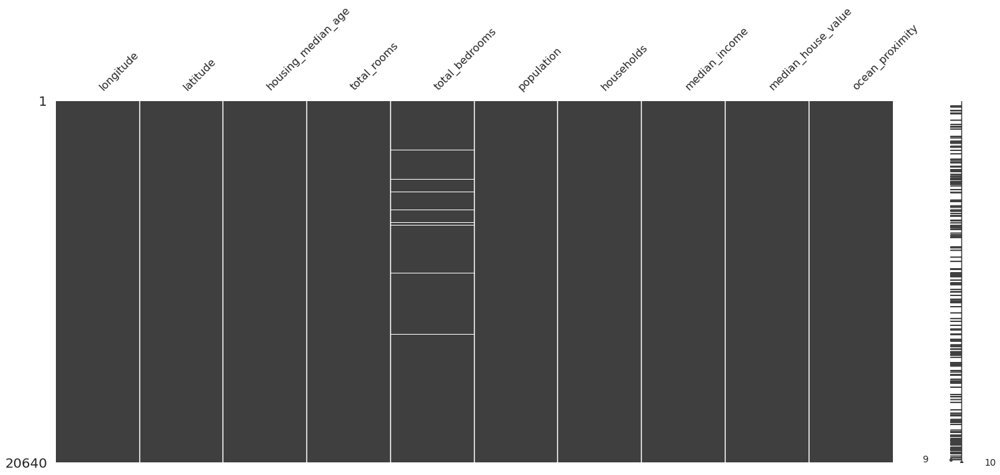

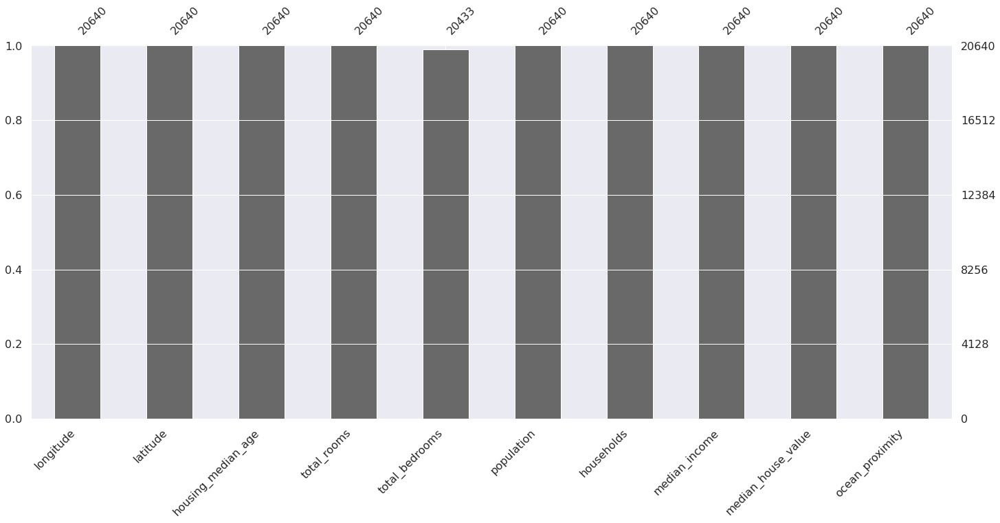

In [53]:
import missingno as msno  # command to find out missing values
msno.matrix(data)
plt.show()
msno.bar(data);
plt.show()

White horizontal line means there is missing value...total_Bedrooms column has missing values..

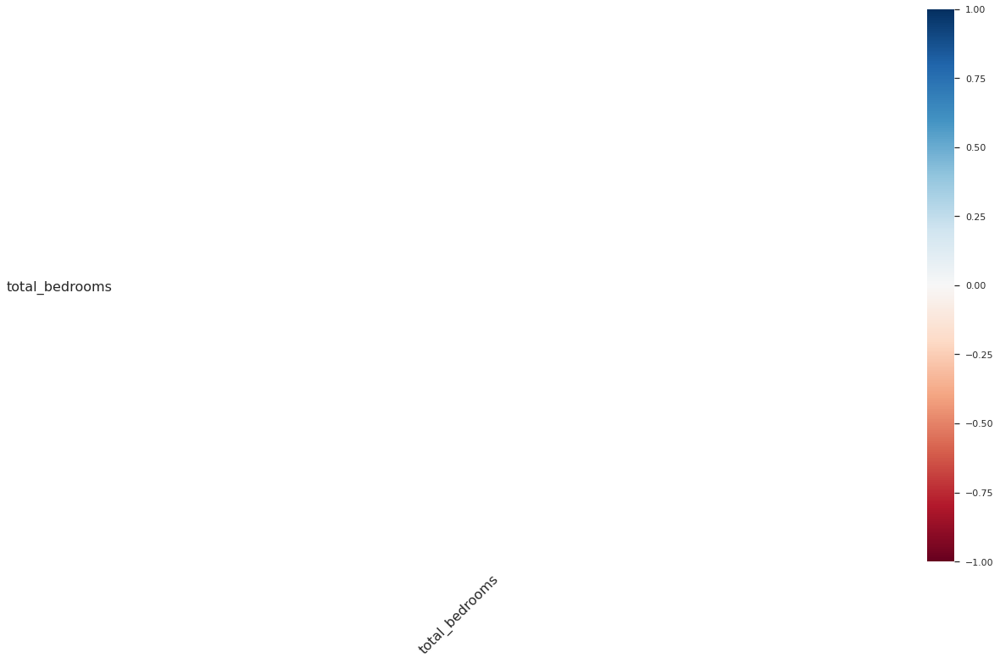

In [54]:
msno.heatmap(data)

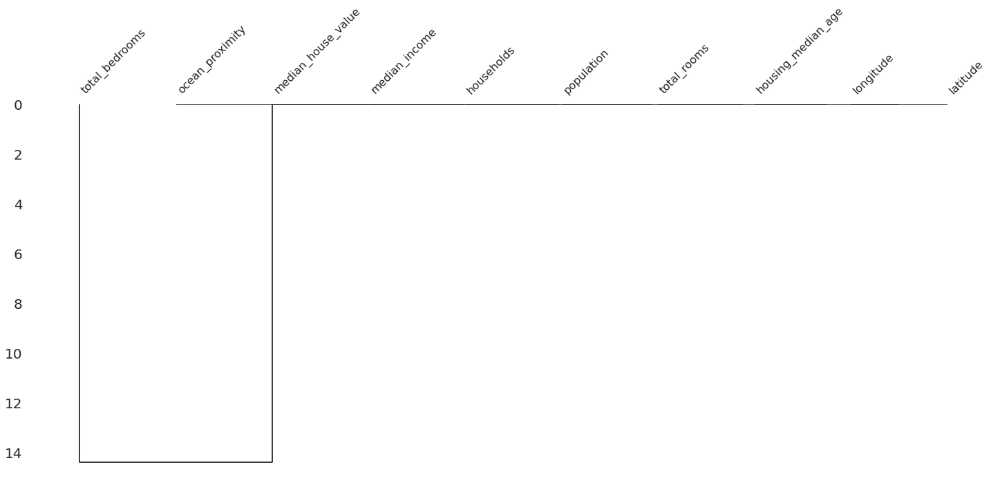

In [55]:
msno.dendrogram(data)

In [56]:
data.profile_report()

## DROP MISSING VALUES FOR NOW

In [57]:
# since there are very few records that have missing total-bedroom feature let us drop those rows

In [58]:
data.dropna(inplace=True)

## DRAW THE MAP OF CALIFORNIA

In [59]:
# find the center of California
max_x, min_x = data['longitude'].max(), data['longitude'].min()
max_y, min_y = data['latitude'].max(), data['latitude'].min()
center_longitude, cemter_latitude = (max_x+min_x)/2 , (max_y+min_y)/2

# plot the map of california

m=folium.Map(location=[center_longitude, cemter_latitude], zoom_start=5.5)

for index, row in data.iterrows():
    folium.Circle(
    radius=3,
    location=[row.latitude, row.longitude],
    color='#E74C3C',
    opacity=0.05,
    fill=False,
    ).add_to(m)
    
# for index, row in data.iterrows():
#     folium.Circle(
#     radius=3,
#     location=[row.longitude, row.latitude],
#     color='#E74C3C',
#     opacity=0.05,
#     fill=False
#     ).add_to(m)
    
m

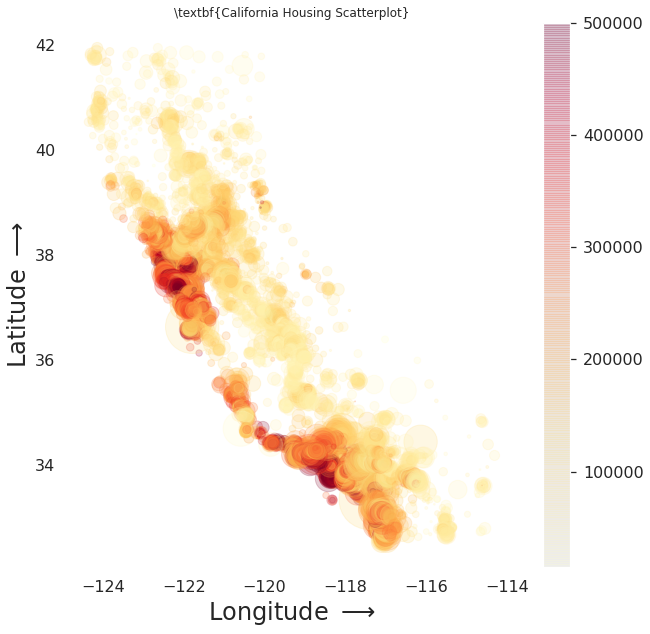

In [60]:
plt.rcParams['figure.figsize'] = '10,10'
plt.rcParams['legend.fontsize'] = 24
plt.rcParams['axes.labelsize'] = 24
plt.rcParams['xtick.labelsize'] = 16
plt.rcParams['ytick.labelsize'] = 16


plt.scatter(x    = data.longitude, 
            y    = data.latitude, 
            c    = data.median_house_value, 
            cmap = 'YlOrRd', 
            s    = data.population/10, 
            alpha= 0.2);
ax = plt.gca();
ax.set_facecolor('#FFFFFF')
plt.xlabel(r'Longitude $\longrightarrow$')
plt.ylabel(r'Latitude $\longrightarrow$')
plt.title(r'\textbf{California Housing Scatterplot}')

plt.colorbar();


In [61]:
# import matplotlib.image as mpimg

# img1 = mpimg.imread('california-housing-map.png')
# img2 = mpimg.imread('california-housing-scatterplot.png')

# plt.rcParams['figure.figsize'] = '25,25'
# plt.rcParams['legend.fontsize'] = 20
# plt.rcParams['axes.labelsize'] = 20
# plt.rcParams['xtick.labelsize'] = 16
# plt.rcParams['ytick.labelsize'] = 16

# plt.figure(1)
# plt.title(r'\textbf{California Housing}')

# plt.subplot(121)
# plt.imshow(img1)

# plt.subplot(122)
# plt.imshow(img2)

In [62]:
data.ocean_proximity = data.ocean_proximity.astype('category')  # Ocean_proximity is a categorical variable..
data.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
longitude,20433,NaN,NaN,NaN,-119.571,2.00358,-124.35,-121.8,-118.49,-118.01,-114.31
latitude,20433,NaN,NaN,NaN,35.6332,2.13635,32.54,33.93,34.26,37.72,41.95
housing_median_age,20433,NaN,NaN,NaN,28.6331,12.5918,1,18,29,37,52
total_rooms,20433,NaN,NaN,NaN,2636.5,2185.27,2,1450,2127,3143,39320
total_bedrooms,20433,NaN,NaN,NaN,537.871,421.385,1,296,435,647,6445
population,20433,NaN,NaN,NaN,1424.95,1133.21,3,787,1166,1722,35682
households,20433,NaN,NaN,NaN,499.433,382.299,1,280,409,604,6082
median_income,20433,NaN,NaN,NaN,3.87116,1.89929,0.4999,2.5637,3.5365,4.744,15.0001
median_house_value,20433,NaN,NaN,NaN,206864,115436,14999,119500,179700,264700,500001
ocean_proximity,20433,5,<1H OCEAN,9034,NaN,NaN,NaN,NaN,NaN,NaN,NaN


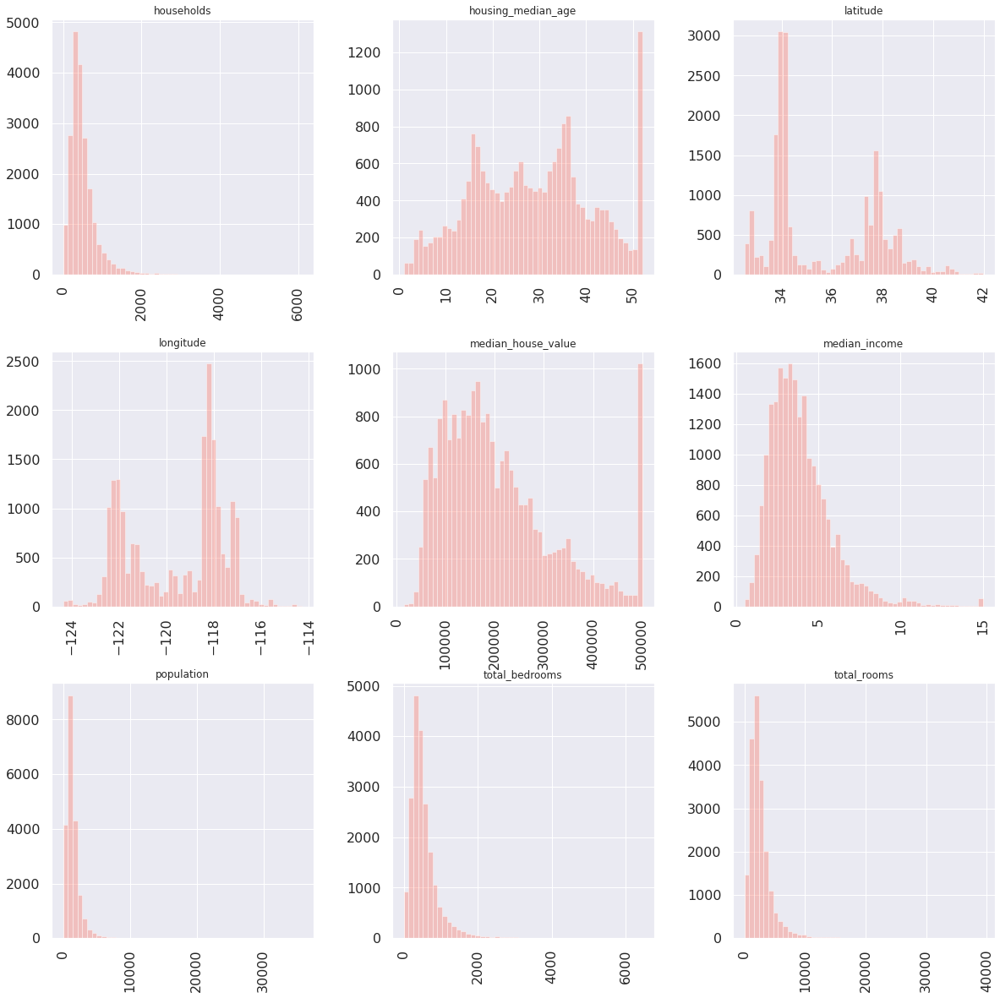

In [63]:
rc('text', usetex=False)
data.hist(bins=50, alpha = 0.4, color='salmon', xrot=90, figsize=(20,20));

# Histogram of each of the variables...
# alpha=0.4 transperent
# xrot ... rotate the number displayed along ..x-axis
# bins=50....50 buckets.. 


In [64]:
# Works but taking longer to load
# sample = data
# fig = sns.pairplot(sample, 
#                    plot_kws = {'alpha': 0.05, 's': 80, 'edgecolor': 'k'}, 
#                    size=4, hue='ocean_proximity');
# fig.map_diag(plt.hist);
# fig.map_upper(plt.scatter);
# fig.map_lower(sns.kdeplot, shade=False, shade_lowest=False, cbar=True);

##...scatter plot of two variables together..demonstrates a bimodal distribution..
##...Scatter plot....kernel density indicator..heat map..

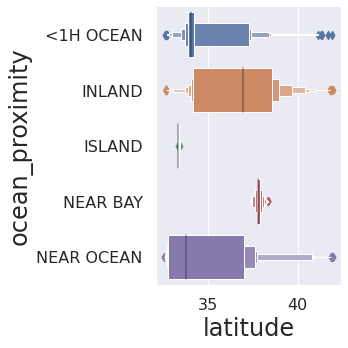

In [65]:
sns.catplot(x="latitude", y="ocean_proximity", kind="boxen",
            data=data.sort_values("ocean_proximity"));

##Category plot..the distribution is all along...

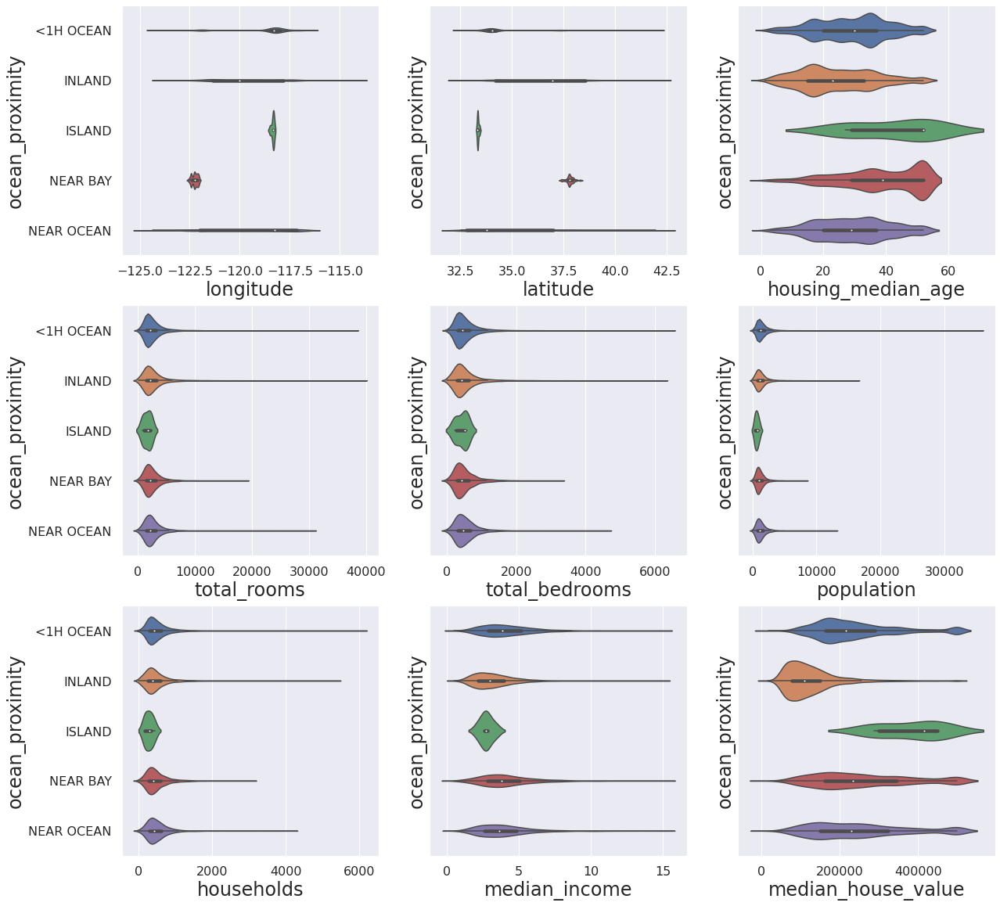

In [66]:
features = data.columns.tolist()
features.remove('ocean_proximity') # it is a categorical

# Because there are 9 numerical features
fig, axes = plt.subplots(3,3, sharey=True, figsize=(20,20))


for i in range(9):
    sns.violinplot(  y    = 'ocean_proximity', 
                     x    = features[i], 
                     data = data,ax=axes[int(i/3), i%3], figsize=(8,8))
    

# similar to box plots....they give you counts..

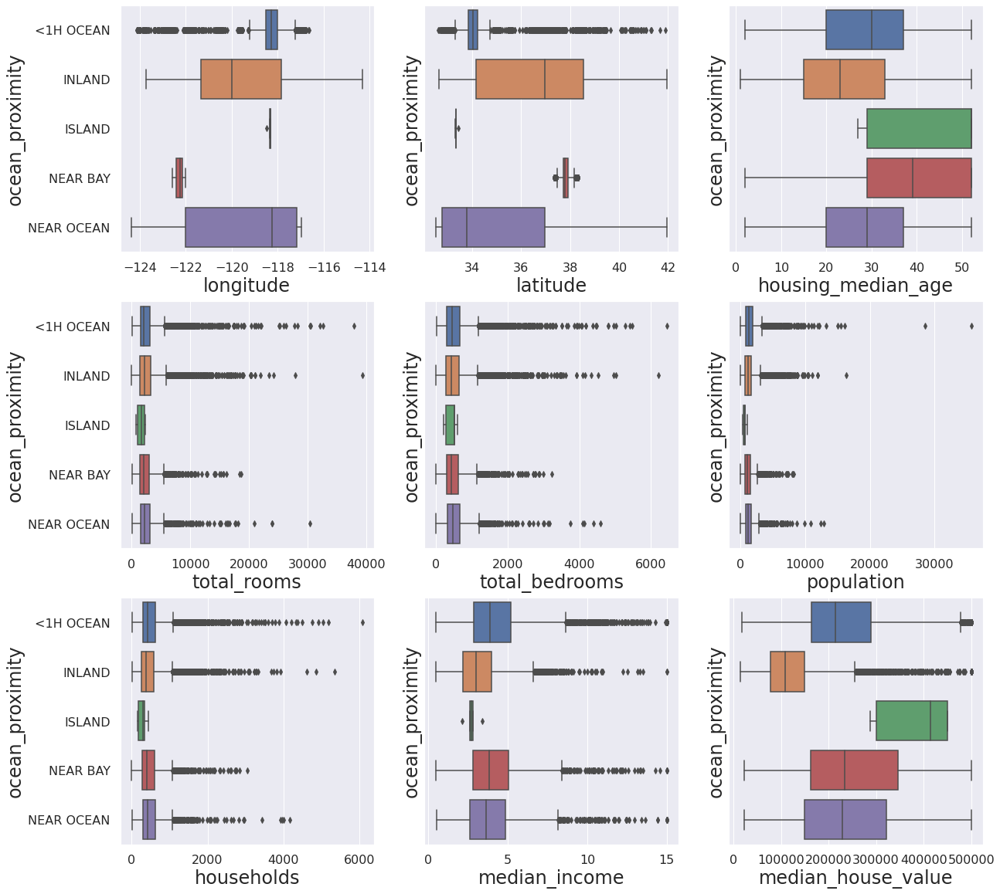

In [67]:
features = data.columns.tolist()
features.remove('ocean_proximity') # it is a categorical

fig, axes = plt.subplots(3,3, sharey=True, figsize=(20,20))

for i in range(9):
    sns.boxplot(  y='ocean_proximity', x = features[i], data=data,ax=axes[int(i/3), i%3] )
    


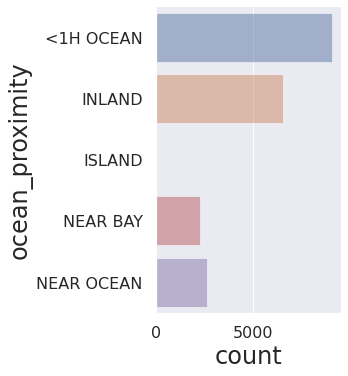

In [68]:
sns.catplot(y="ocean_proximity", kind="count",  alpha=0.5, data=data);

In [69]:
corr = data.corr()
corr

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
longitude,1.000000,-0.924616,-0.109357,0.045480,0.069608,0.100270,0.056513,-0.015550,-0.045398
latitude,-0.924616,1.000000,0.011899,-0.036667,-0.066983,-0.108997,-0.071774,-0.079626,-0.144638
housing_median_age,-0.109357,0.011899,1.000000,-0.360628,-0.320451,-0.295787,-0.302768,-0.118278,0.106432
total_rooms,0.045480,-0.036667,-0.360628,1.000000,0.930380,0.857281,0.918992,0.197882,0.133294
total_bedrooms,0.069608,-0.066983,-0.320451,0.930380,1.000000,0.877747,0.979728,-0.007723,0.049686
population,0.100270,-0.108997,-0.295787,0.857281,0.877747,1.000000,0.907186,0.005087,-0.025300
households,0.056513,-0.071774,-0.302768,0.918992,0.979728,0.907186,1.000000,0.013434,0.064894
median_income,-0.015550,-0.079626,-0.118278,0.197882,-0.007723,0.005087,0.013434,1.000000,0.688355
median_house_value,-0.045398,-0.144638,0.106432,0.133294,0.049686,-0.025300,0.064894,0.688355,1.000000


In [70]:
# to get the latex output for the document.
print(corr.to_latex())

\begin{tabular}{lrrrrrrrrr}
\toprule
{} &  longitude &  latitude &  housing\_median\_age &  total\_rooms &  total\_bedrooms &  population &  households &  median\_income &  median\_house\_value \\
\midrule
longitude          &   1.000000 & -0.924616 &           -0.109357 &     0.045480 &        0.069608 &    0.100270 &    0.056513 &      -0.015550 &           -0.045398 \\
latitude           &  -0.924616 &  1.000000 &            0.011899 &    -0.036667 &       -0.066983 &   -0.108997 &   -0.071774 &      -0.079626 &           -0.144638 \\
housing\_median\_age &  -0.109357 &  0.011899 &            1.000000 &    -0.360628 &       -0.320451 &   -0.295787 &   -0.302768 &      -0.118278 &            0.106432 \\
total\_rooms        &   0.045480 & -0.036667 &           -0.360628 &     1.000000 &        0.930380 &    0.857281 &    0.918992 &       0.197882 &            0.133294 \\
total\_bedrooms     &   0.069608 & -0.066983 &           -0.320451 &     0.930380 &        1.000000 &    0.877747 &

In [71]:
corr

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
longitude,1.000000,-0.924616,-0.109357,0.045480,0.069608,0.100270,0.056513,-0.015550,-0.045398
latitude,-0.924616,1.000000,0.011899,-0.036667,-0.066983,-0.108997,-0.071774,-0.079626,-0.144638
housing_median_age,-0.109357,0.011899,1.000000,-0.360628,-0.320451,-0.295787,-0.302768,-0.118278,0.106432
total_rooms,0.045480,-0.036667,-0.360628,1.000000,0.930380,0.857281,0.918992,0.197882,0.133294
total_bedrooms,0.069608,-0.066983,-0.320451,0.930380,1.000000,0.877747,0.979728,-0.007723,0.049686
population,0.100270,-0.108997,-0.295787,0.857281,0.877747,1.000000,0.907186,0.005087,-0.025300
households,0.056513,-0.071774,-0.302768,0.918992,0.979728,0.907186,1.000000,0.013434,0.064894
median_income,-0.015550,-0.079626,-0.118278,0.197882,-0.007723,0.005087,0.013434,1.000000,0.688355
median_house_value,-0.045398,-0.144638,0.106432,0.133294,0.049686,-0.025300,0.064894,0.688355,1.000000


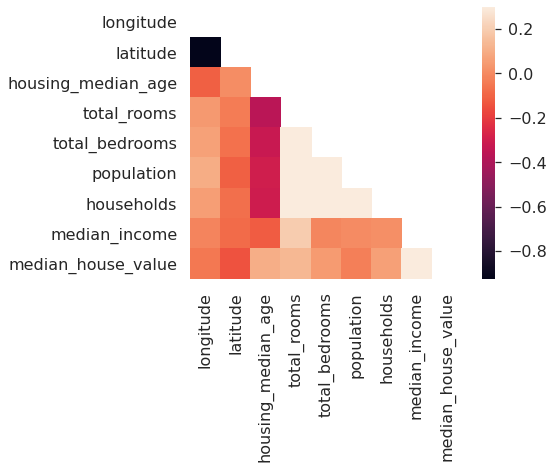

In [72]:
import numpy as np
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(7, 5))
    ax = sns.heatmap(corr, mask=mask, vmax=.3, square=True)

# basic regression model
Let us now build a regression model for the housing data set.

## data preprocessing

Here we perform two steps
1. Convert the categorical to one-hot encoding
2. Drop the missing values
3. Extract out the feature-space X and the target (label)variable.

In [73]:
data_one_hot=pd.get_dummies(data,
                           columns=['ocean_proximity'],
                           prefix=['ocean_proximity'])
data_one_hot.dropna(inplace=True)
y=data_one_hot.median_house_value
X=data_one_hot.drop('median_house_value',axis=1)

X.describe(include='all').transpose()

# preprocessing..
# one_hot...convert the ocean_proximity in to a categorical variable...


,count,mean,std,min,25%,50%,75%,max
longitude,20433.0,-119.570689,2.003578,-124.3500,-121.8000,-118.4900,-118.010,-114.3100
latitude,20433.0,35.633221,2.136348,32.5400,33.9300,34.2600,37.720,41.9500
housing_median_age,20433.0,28.633094,12.591805,1.0000,18.0000,29.0000,37.000,52.0000
total_rooms,20433.0,2636.504233,2185.269567,2.0000,1450.0000,2127.0000,3143.000,39320.0000
total_bedrooms,20433.0,537.870553,421.385070,1.0000,296.0000,435.0000,647.000,6445.0000
population,20433.0,1424.946949,1133.208490,3.0000,787.0000,1166.0000,1722.000,35682.0000
households,20433.0,499.433465,382.299226,1.0000,280.0000,409.0000,604.000,6082.0000
median_income,20433.0,3.871162,1.899291,0.4999,2.5637,3.5365,4.744,15.0001
ocean_proximity_<1H OCEAN,20433.0,0.442128,0.496652,0.0000,0.0000,0.0000,1.000,1.0000
ocean_proximity_INLAND,20433.0,0.317917,0.465678,0.0000,0.0000,0.0000,1.000,1.0000


## log transform

We noticed before that some of the features show a strong right skew. In order to address it, let us take a log-transform in order to try to make them look a bit more symmetrical.


Bick of a duck as a skew measure..


In [74]:
X.total_bedrooms = np.log(X.total_bedrooms)
X.population = np.log(X.population)
X.total_rooms = np.log(X.total_rooms)
X.households = np.log(X.households)
X.median_income = np.log(X.median_income)
y = np.log(y)
X.describe().transpose()


# comment out this code and see the model performance..

,count,mean,std,min,25%,50%,75%,max
longitude,20433.0,-119.570689,2.003578,-124.350000,-121.800000,-118.490000,-118.010000,-114.310000
latitude,20433.0,35.633221,2.136348,32.540000,33.930000,34.260000,37.720000,41.950000
housing_median_age,20433.0,28.633094,12.591805,1.000000,18.000000,29.000000,37.000000,52.000000
total_rooms,20433.0,7.628742,0.751814,0.693147,7.279319,7.662468,8.052933,10.579489
total_bedrooms,20433.0,6.051063,0.732785,0.000000,5.690359,6.075346,6.472346,8.771060
population,20433.0,7.023732,0.738632,1.098612,6.668228,7.061334,7.451242,10.482402
households,20433.0,5.980637,0.733216,0.000000,5.634790,6.013715,6.403574,8.713089
median_income,20433.0,1.244626,0.470637,-0.693347,0.941452,1.263138,1.556881,2.708057
ocean_proximity_<1H OCEAN,20433.0,0.442128,0.496652,0.000000,0.000000,0.000000,1.000000,1.000000
ocean_proximity_INLAND,20433.0,0.317917,0.465678,0.000000,0.000000,0.000000,1.000000,1.000000


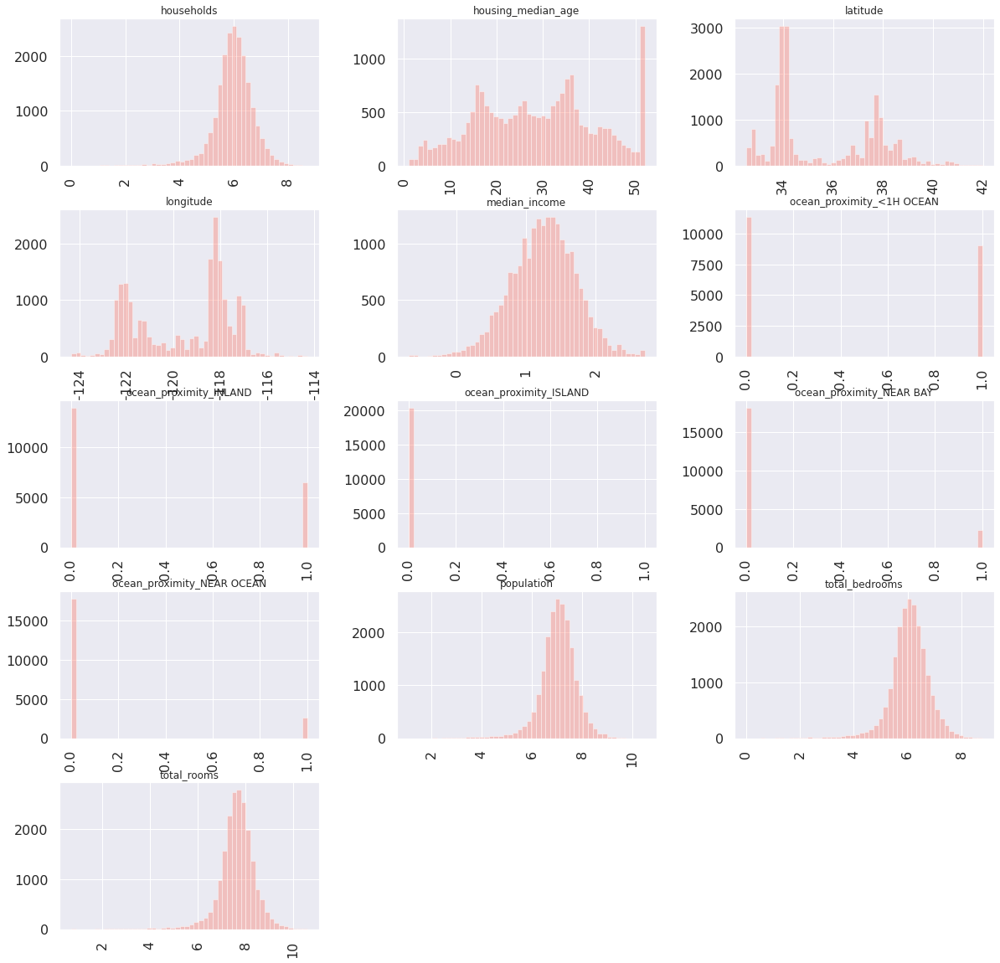

In [75]:
rc('text', usetex=False)
X.hist(bins=50, alpha = 0.4, color='salmon', xrot=90, figsize=(20,20), layout=(5,3));

# Post transformation the skew is gone...see the plots below..

## split the data in test and train sets

In [76]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0, )

## simple linear regression model

Let us build a baseline linear regression model with this data:

In [77]:
from sklearn.linear_model import LinearRegression           # linear regression
from sklearn.metrics import mean_squared_error, r2_score    # model metrics

linear_model= LinearRegression()
linear_model.fit(X_train, y_train)
labels = linear_model.predict(X_test)

# Check how good are the predictions?

mse = mean_squared_error(y_test, labels)
print(f"Mean squared error: {mse:.2f}")

r2=r2_score(y_test,labels)
print(f"Co-efficient of dermination (R^2) : {r2:0.4f}")
print(rf'Model coefficients are: {linear_model.coef_}')

# fairly low mean squared error..
# R^2 is 69%
# If we remove the outlier the results may be better..
# outliers in the box plot..anything outside the whiskers are outliers....
# Original plot also shows the outliers..
# median income...lingitude...population..total_bedrooms...
# It is not clear if the model is good enough..

Mean squared error: 0.10
Co-efficient of dermination (R^2) : 0.6911
Model coefficients are: [-0.16538399 -0.16407788  0.00301923 -0.19099691  0.41382609 -0.37242703
  0.16891577  0.76365496 -0.05401582 -0.3199041   0.57082991 -0.09627221
 -0.10063778]


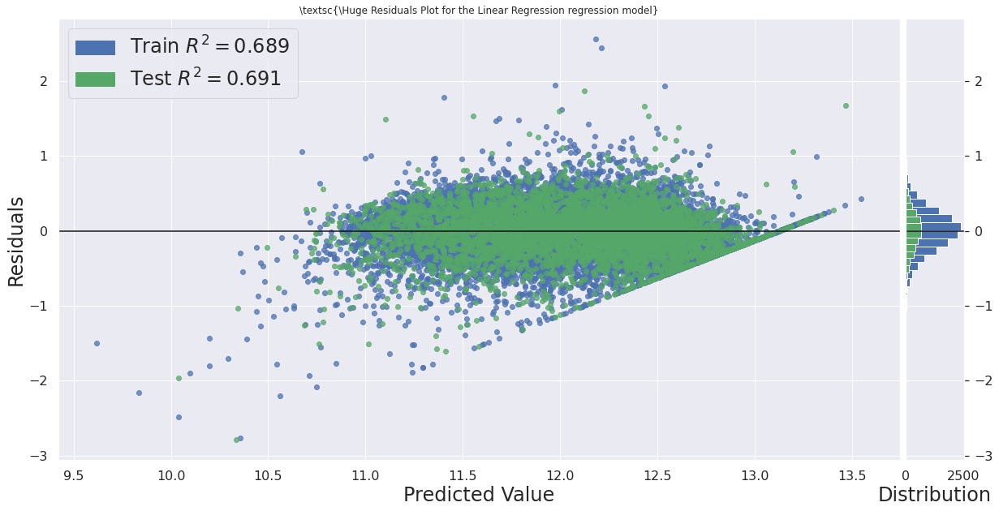

In [78]:
rc ('text', usetex=False) # Enable it selectively
from yellowbrick.regressor import residuals_plot
plt.rcParams[ 'figure.figsize' ] = '20,10'               # landscape format figures
viz = residuals_plot(linear_model, X_train, y_train, X_test, y_test, 
                     title=r'\textsc{\Huge Residuals Plot for the Linear Regression regression model}')

# Residual analysis tells you about the model..
# the model has a bell shape..
# homoskidasticity...
#Model the not perfect but seems good..


### prediction errors plot

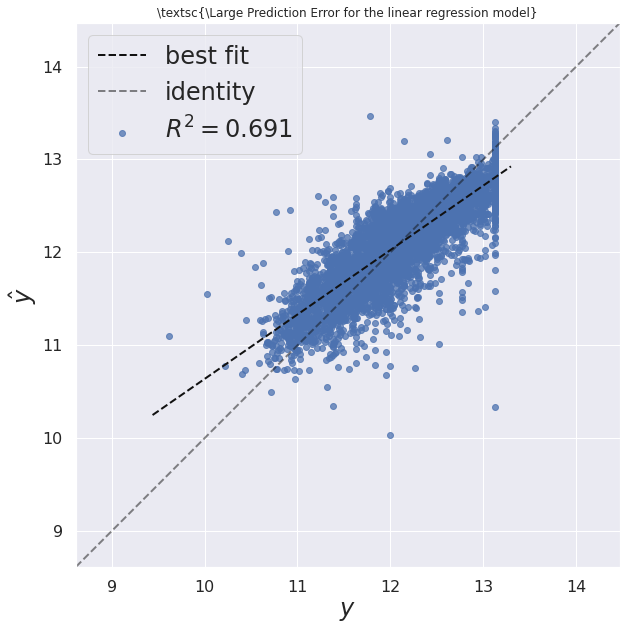

In [79]:
from yellowbrick.regressor import prediction_error

visualizer = prediction_error(linear_model, X_train, y_train, X_test, y_test,
                             title=r'\textsc{\Large Prediction Error for the linear regression model}',
                             xlabel=r'$\mathbf{y}$', ylabel=r'$\mathbf{\hat{y}}$')

# Relation between prediction and reality...
# the relation is positive...


### Cook's distance to see point of high influence

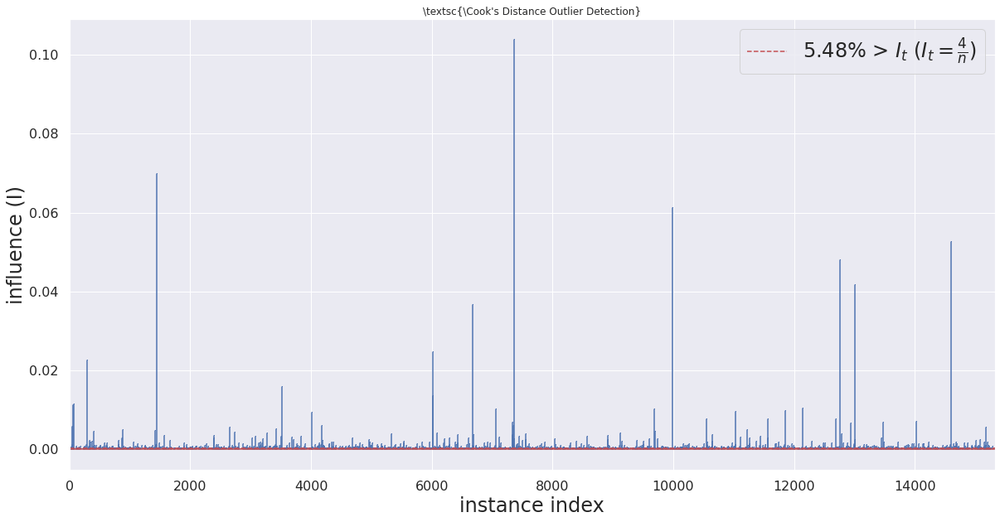

CooksDistance(ax=<matplotlib.axes._subplots.AxesSubplot object at 0x7f40ef14d1d0>)

In [80]:
from yellowbrick.regressor import cooks_distance
cooks_distance(
    X_train, y_train,
    draw_threshold=True,
    linefmt="C0-", markerfmt=",",
    title=r"\textsc{\Cook's Distance Outlier Detection}"
    
)

## would regularization help?

Would regularization using Ridge-Regularization model for the regression give us a better result?

In [81]:
from sklearn.linear_model import RidgeCV

ridge_model = RidgeCV(alphas=[1e-3, 1e-3, 1e-1, 1]).fit(X_train, y_train)

labels = ridge_model.predict(X_test)

# Check how good are the predictions?
mse         = mean_squared_error(y_test, labels)
print(f"Mean squared error: {mse:.2f}")
r2 = r2_score(y_test, labels)
print(rf"Coefficient of Determination (R^2):{r2:0.4f}")
print(rf'Model coefficients are: {ridge_model.coef_}')

# R^2 is 69.12%
# look at the coefficients..
# Linear model Data does not have overfitting problem..


Mean squared error: 0.10
Coefficient of Determination (R^2):0.6912
Model coefficients are: [-0.1654036  -0.16410165  0.0030193  -0.19076031  0.4136164  -0.37241136
  0.1688773   0.76352731 -0.05030601 -0.31620123  0.55599364 -0.09255258
 -0.09693382]


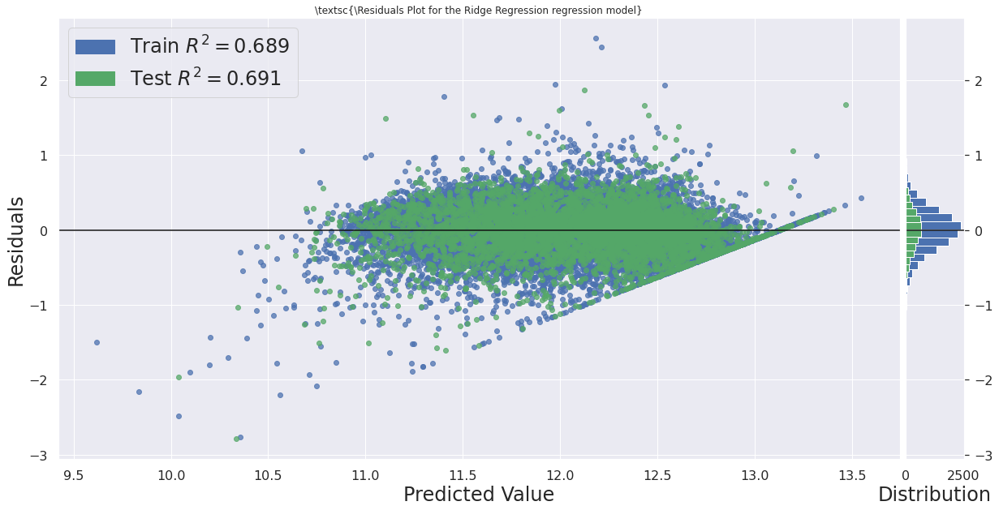

In [82]:
from yellowbrick.regressor import residuals_plot
plt.rcParams[ 'figure.figsize' ] = '20,10'               # landscape format figures
viz = residuals_plot(ridge_model, X_train, y_train, X_test, y_test, 
                     title=r'\textsc{\Residuals Plot for the Ridge Regression regression model}')

### prediction errors plot

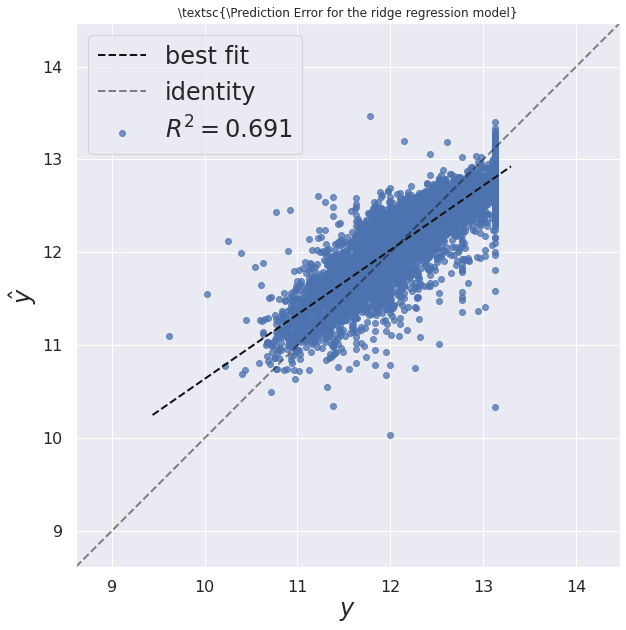

In [83]:
from yellowbrick.regressor import prediction_error

visualizer = prediction_error(ridge_model, X_train, y_train, X_test, y_test,
                             title=r'\textsc{\Prediction Error for the ridge regression model}',
                             xlabel=r'$\mathbf{y}$', ylabel=r'$\mathbf{\hat{y}}$')


# Using Decision Tree regressor

Let us now apply decision tree regressor to this data set

In [84]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import export_graphviz  
tree_model = DecisionTreeRegressor(max_depth=5, random_state=42,).fit(X_train, y_train)

labels = tree_model.predict(X_test)

# Check how good are the predictions?
mse         = mean_squared_error(y_test, labels)
print(f"Mean squared error: {mse:.2f}")
r2 = r2_score(y_test, labels)
print(rf"Coefficient of Determination (R^2):{r2:0.4f}")


Mean squared error: 0.10
Coefficient of Determination (R^2):0.6772


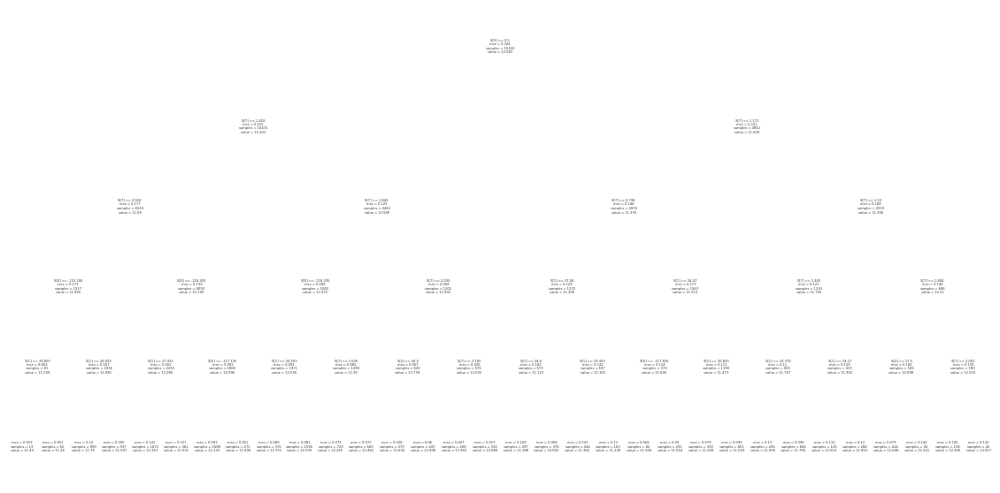

In [85]:
from sklearn.tree import plot_tree
plot_tree(tree_model);

In [86]:
import graphviz
dot_data = export_graphviz(tree_model, out_file=None, 
                           filled=True, rounded=True,  
                           special_characters=True)  
graph = graphviz.Source(dot_data)
graph.render("CaliforniaHousing") 

'CaliforniaHousing.pdf'

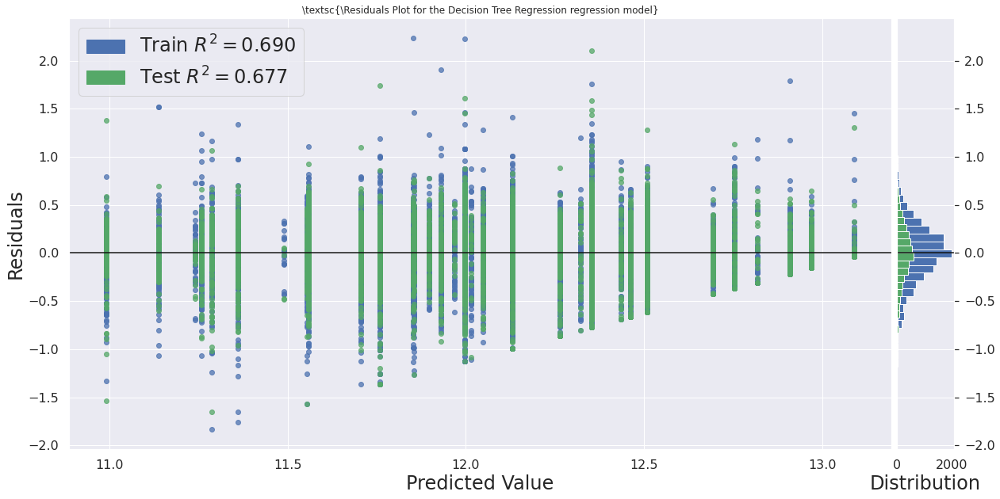

In [87]:
from yellowbrick.regressor import residuals_plot
plt.rcParams[ 'figure.figsize' ] = '20,10'               # landscape format figures
viz = residuals_plot(tree_model, X_train, y_train, X_test, y_test, 
                     title=r'\textsc{\Residuals Plot for the Decision Tree Regression regression model}')


### Prediction Errors Plot

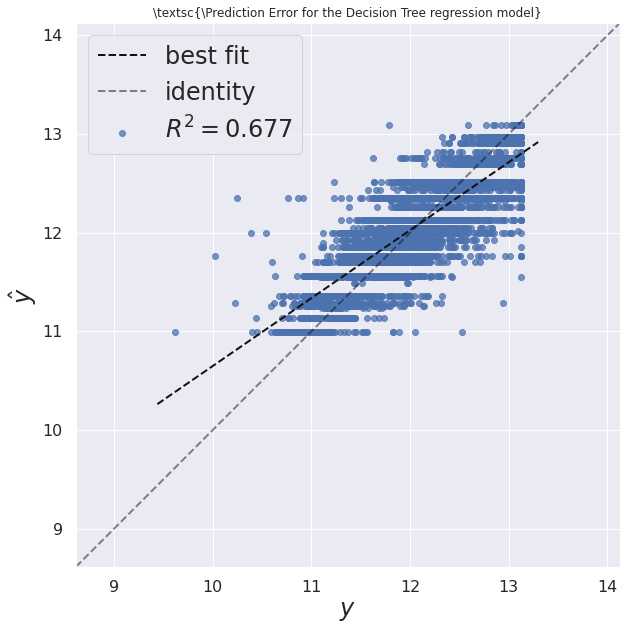

In [88]:


from yellowbrick.regressor import prediction_error

visualizer = prediction_error(tree_model, X_train, y_train, X_test, y_test,
                             title=r'\textsc{\Prediction Error for the Decision Tree regression model}',
                             xlabel=r'$\mathbf{y}$', ylabel=r'$\mathbf{\hat{y}}$')

# Random Forest Regressor¶

In [89]:
X.describe(include='all').transpose()


,count,mean,std,min,25%,50%,75%,max
longitude,20433.0,-119.570689,2.003578,-124.350000,-121.800000,-118.490000,-118.010000,-114.310000
latitude,20433.0,35.633221,2.136348,32.540000,33.930000,34.260000,37.720000,41.950000
housing_median_age,20433.0,28.633094,12.591805,1.000000,18.000000,29.000000,37.000000,52.000000
total_rooms,20433.0,7.628742,0.751814,0.693147,7.279319,7.662468,8.052933,10.579489
total_bedrooms,20433.0,6.051063,0.732785,0.000000,5.690359,6.075346,6.472346,8.771060
population,20433.0,7.023732,0.738632,1.098612,6.668228,7.061334,7.451242,10.482402
households,20433.0,5.980637,0.733216,0.000000,5.634790,6.013715,6.403574,8.713089
median_income,20433.0,1.244626,0.470637,-0.693347,0.941452,1.263138,1.556881,2.708057
ocean_proximity_<1H OCEAN,20433.0,0.442128,0.496652,0.000000,0.000000,0.000000,1.000000,1.000000
ocean_proximity_INLAND,20433.0,0.317917,0.465678,0.000000,0.000000,0.000000,1.000000,1.000000


In [90]:
y.describe(include='all').transpose()


count    20433.000000
mean        12.084862
std          0.569222
min          9.615739
25%         11.691072
50%         12.099044
75%         12.486352
max         13.122365
Name: median_house_value, dtype: float64

In [91]:
from sklearn.ensemble import RandomForestRegressor

forest_model = RandomForestRegressor(n_estimators = 1000,
                                     n_jobs = 20,
                                     random_state = 42).fit(X_train, y_train);

In [92]:
labels = forest_model.predict(X_test)

# Check how good are the predictions?
mse         = mean_squared_error(y_test, labels)
print(f"Mean squared error: {mse:.2f}")
r2 = r2_score(y_test, labels)
print(rf"Coefficient of Determination (R^2):{r2:0.4f}")

Mean squared error: 0.05
Coefficient of Determination (R^2):0.8365


## Goodness of the model diagnosis

### Residual Check

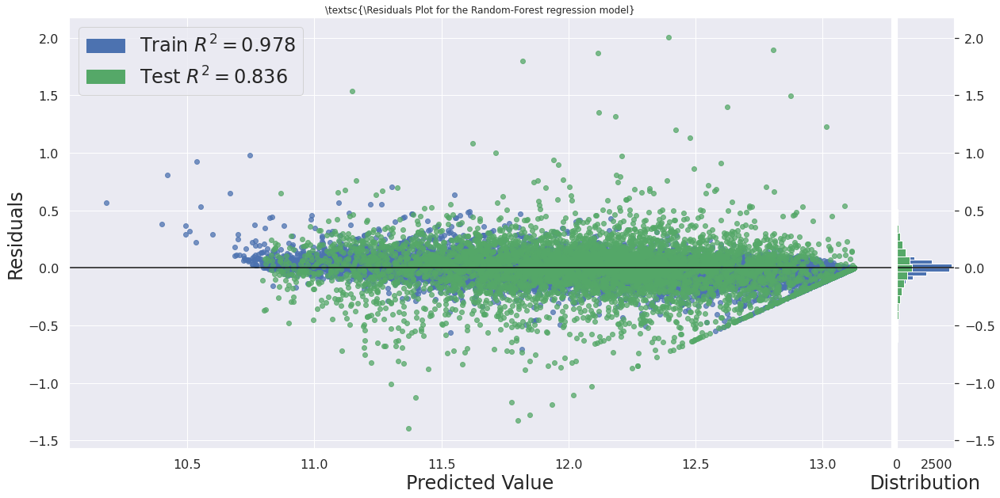

In [93]:
rc ('text', usetex=False) # Enable it selectively

from yellowbrick.regressor import residuals_plot
plt.rcParams[ 'figure.figsize' ] = '20,10'               # landscape format figures
viz = residuals_plot(forest_model, X_train, y_train, X_test, y_test, 
                     title=r'\textsc{\Residuals Plot for the Random-Forest regression model}')


### Prediction Errors Plot


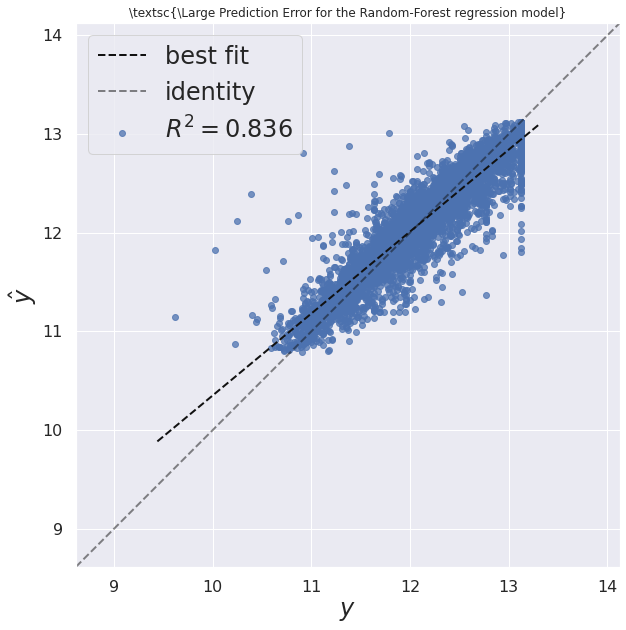

In [94]:
from yellowbrick.regressor import prediction_error

visualizer = prediction_error(forest_model, X_train, y_train, X_test, y_test,
                             title=r'\textsc{\Large Prediction Error for the Random-Forest regression model}',
                             xlabel=r'$\mathbf{y}$', ylabel=r'$\mathbf{\hat{y}}$')

### Visualize a tree in the random forest

In [95]:
from sklearn.tree import plot_tree
plot_tree(forest_model.estimators_[0]);

Error in callback <function flush_figures at 0x7f4159a003b0> (for post_execute):


KeyboardInterrupt: 

## Feature Importance

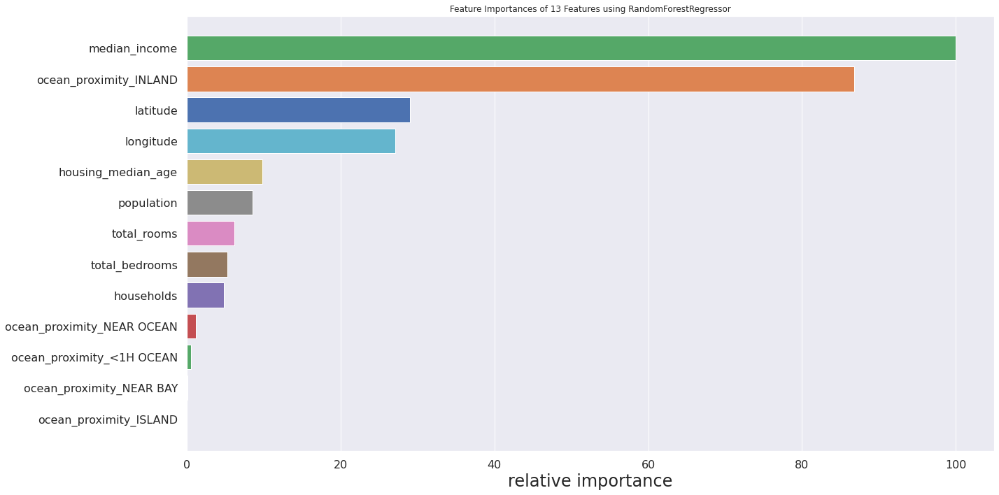

In [96]:
rc ('text', usetex=False) # disable (some features have _ in their names : it throws latex off)
from yellowbrick.model_selection import feature_importances
feature_importances(forest_model, X, y);

### Shapley Values

In [ ]:
# import shap library

! pip install -q shap
import shap

In [ ]:
# Explain the model's prediction using SHAP
explainer = shap.TreeExplainer(forest_model)

sample = X_train.sample(1000)
shap_values = explainer.shap_values(sample)

# visualize the first prediction's explanation 
#shap.initjs()
#shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:])

In [ ]:
shap.summary_plot(shap_values, sample, plot_type="bar")

In [ ]:
# Let us consider a random row!
row = np.random.randint(0, shap_values.shape[0])
print (f'We are going to look at the feature importance for the point in feature space given by data instance: {row}')

In [ ]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[row,:], X_train.iloc[row,:])

### Visualize the shapley values force plot

In [ ]:
shap.force_plot(explainer.expected_value, shap_values, X_train)

# Support Vector Machine Regressor

In [ ]:
from sklearn.svm import SVR
svr = SVR(C=20)
svr.fit(X_train, y_train)

In [ ]:
# Now make the predictions
yhat = svr.predict(X_test)
# Check how good are the predictions?
mse         = mean_squared_error(y_test, yhat)
print(f"Mean squared error: {mse:.2f}")
r2 = r2_score(y_test, yhat)
print(rf"Coefficient of Determination (R^2):{r2:0.4f}")

## Goodness of model diagnostics

### Residual's Check

In [ ]:
rc ('text', usetex=True) # Enable it selectively

from yellowbrick.regressor import residuals_plot
plt.rcParams[ 'figure.figsize' ] = '20,10'               # landscape format figures
viz = residuals_plot(svr, X_train, y_train, X_test, y_test, 
                     title=r'\textsc{\Huge Residuals Plot for the SVM regression model}')

### Prediction Errors Plot

In [ ]:
from yellowbrick.regressor import prediction_error

visualizer = prediction_error(svr, X_train, y_train, X_test, y_test,
                             title=r'\textsc{\Large Prediction Error for the SVR regression model}',
                             xlabel=r'$\mathbf{y}$', ylabel=r'$\mathbf{\hat{y}}$')

In [ ]:
! pip install -q shap
import shap
sample = X_train.sample(100)
explainer = shap.KernelExplainer(svr.predict, sample)
shap_values = explainer.shap_values(sample)

In [ ]:
shap.summary_plot(shap_values, sample)

In [ ]:
shap.force_plot(explainer.expected_value, shap_values, sample)

In [ ]:
shap.summary_plot(shap_values, sample, plot_type='bar')